In [2]:
""" 
Created on Mon Jan 22 11:20:28 2024

@author: Michaela Alksne 

This notebook is for plotting spectrograms from train/validation/test data 
This is a very important step to do before you train a model!
Always visualize your labels! 

Here we read in our annotated data and plot using opensoundscape to make the spectrograms. We also visualize the labels. 

"""

' \nCreated on Mon Jan 22 11:20:28 2024\n\n@author: Michaela Alksne \n\nThis notebook is for plotting spectrograms from either train/validation/test data or from modified annotations if the user wants to verify their annotations. \nThis is a very important step to do before you train a model!\nAlways visualize your labels! \n\nHere we read in our annotated data and plot using opensoundscape to make the spectrograms \n\nthis notebook details how to visualize spectrograms used for training CNN\n\n'

In [67]:
import opensoundscape
import glob
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import sklearn
import librosa
import torch
import random
import seaborn as sns
from pathlib import Path


In [3]:
# read in train/validation/test datasets
train_clips = pd.read_csv('../../data/processed/train.csv')
print(train_clips)

                                                   file  ...  B NE Pacific
0     ..\..\data\raw\DCPP01A_d01_121112_122652.d100....  ...             0
1     ..\..\data\raw\DCPP01A_d01_121109_191242.d100....  ...             0
2     ..\..\data\raw\DCPP01A_d01_121112_122652.d100....  ...             0
3     ..\..\data\raw\DCPP01A_d01_121112_122652.d100....  ...             0
4     ..\..\data\raw\DCPP01A_d01_121109_191242.d100....  ...             0
...                                                 ...  ...           ...
4495  ..\..\data\raw\DCPP01A_d01_121115_054102.d100....  ...             0
4496  ..\..\data\raw\DCPP01A_d01_121112_122652.d100....  ...             0
4497  ..\..\data\raw\DCPP01A_d01_121109_191242.d100....  ...             0
4498  ..\..\data\raw\DCPP01A_d01_121109_191242.d100....  ...             0
4499  ..\..\data\raw\DCPP01A_d01_121115_054102.d100....  ...             0

[4500 rows x 5 columns]


File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 32040, End time:32070
Annotations:A NE Pacific=1, B NE Pacific=0


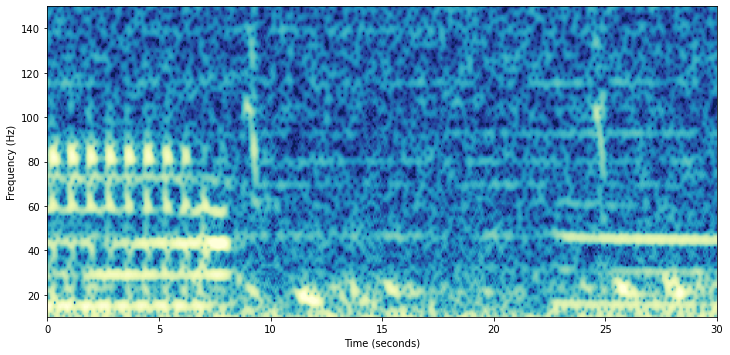

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 173040, End time:173070
Annotations:A NE Pacific=1, B NE Pacific=0


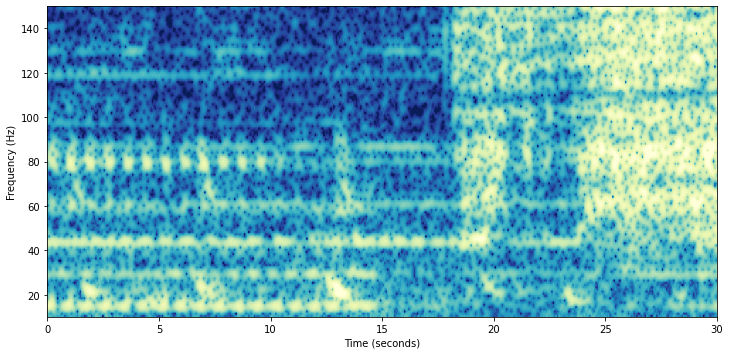

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 98460, End time:98490
Annotations:A NE Pacific=1, B NE Pacific=0


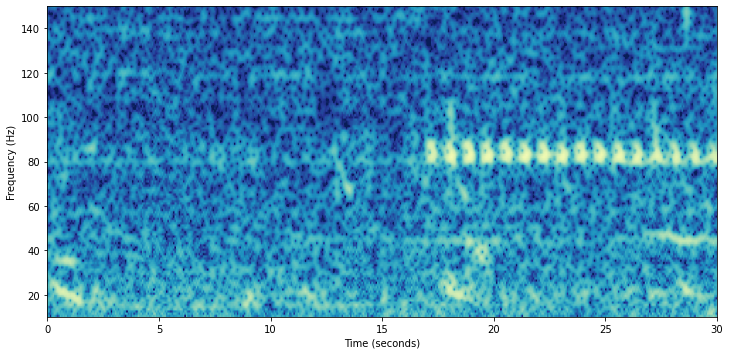

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 30380, End time:30410
Annotations:A NE Pacific=1, B NE Pacific=0


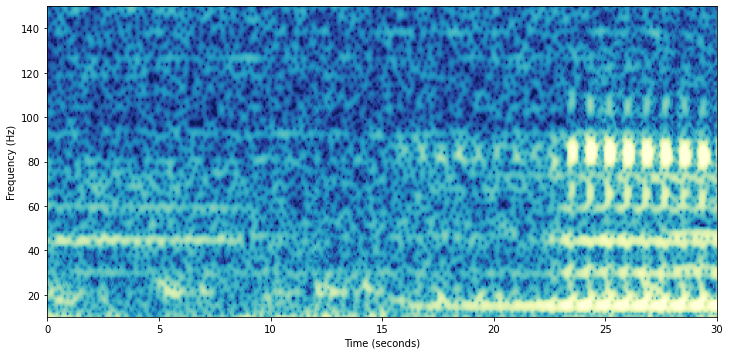

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 93880, End time:93910
Annotations:A NE Pacific=1, B NE Pacific=0


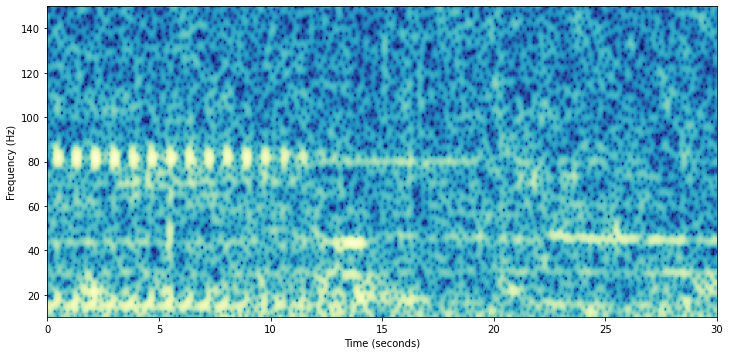

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 76800, End time:76830
Annotations:A NE Pacific=1, B NE Pacific=0


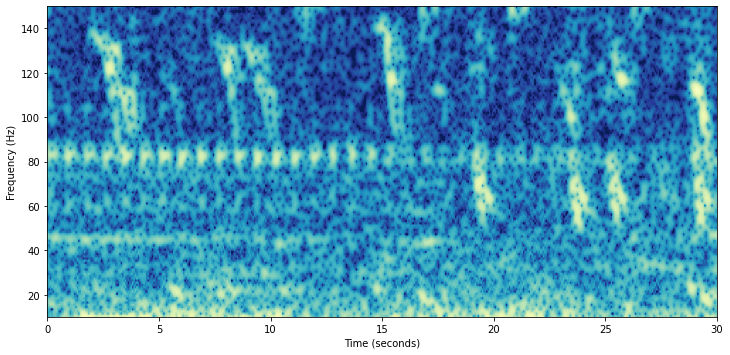

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 145900, End time:145930
Annotations:A NE Pacific=1, B NE Pacific=0


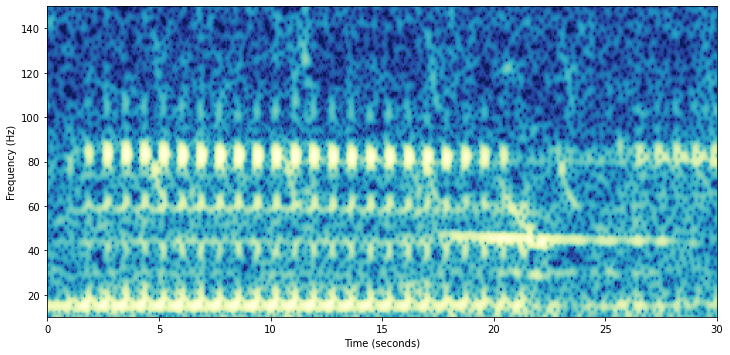

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 87260, End time:87290
Annotations:A NE Pacific=1, B NE Pacific=0


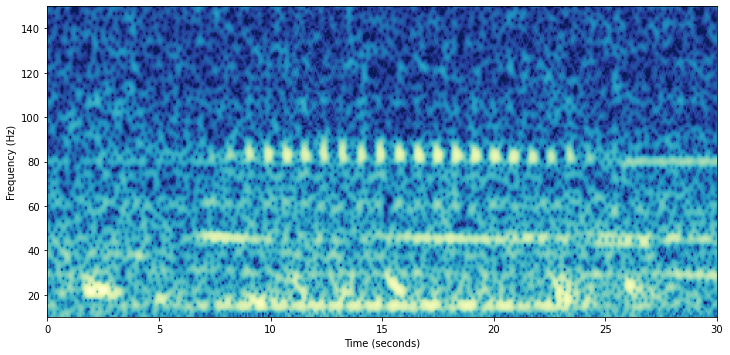

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 204940, End time:204970
Annotations:A NE Pacific=1, B NE Pacific=0


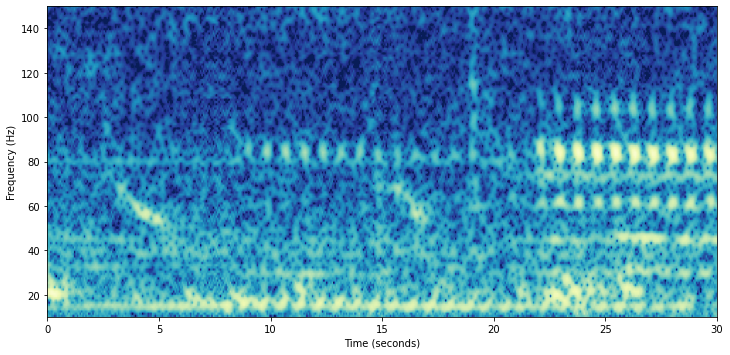

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 71100, End time:71130
Annotations:A NE Pacific=1, B NE Pacific=0


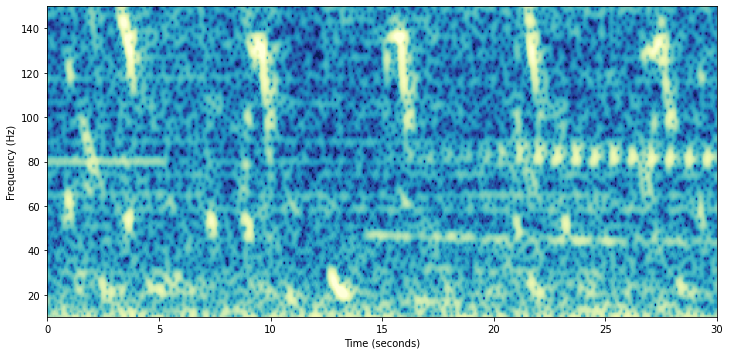

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 126180, End time:126210
Annotations:A NE Pacific=1, B NE Pacific=0


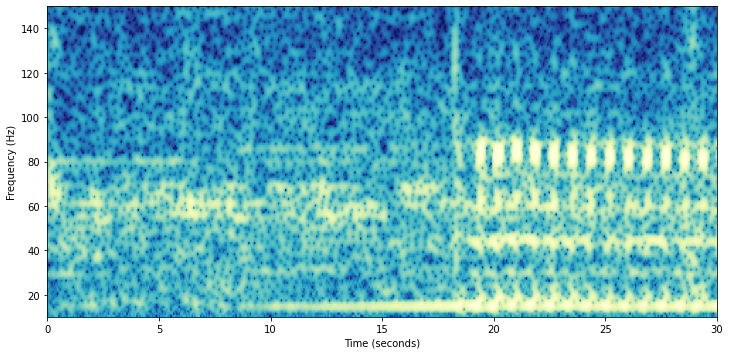

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 73740, End time:73770
Annotations:A NE Pacific=1, B NE Pacific=0


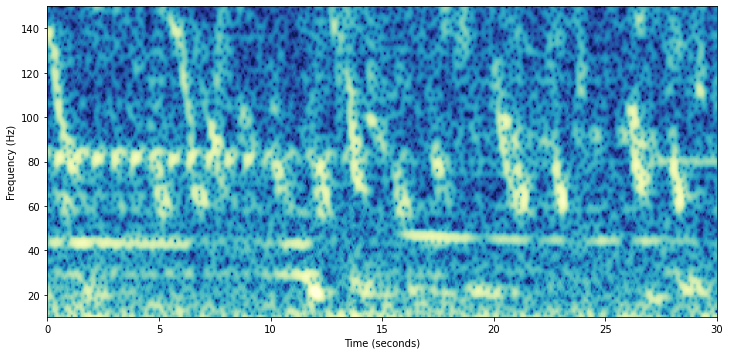

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 198240, End time:198270
Annotations:A NE Pacific=1, B NE Pacific=0


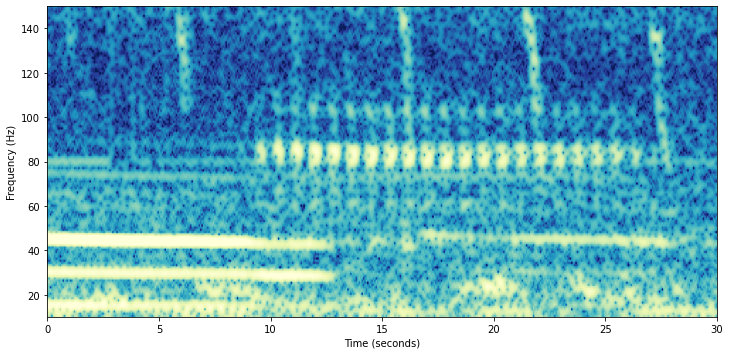

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 169260, End time:169290
Annotations:A NE Pacific=1, B NE Pacific=0


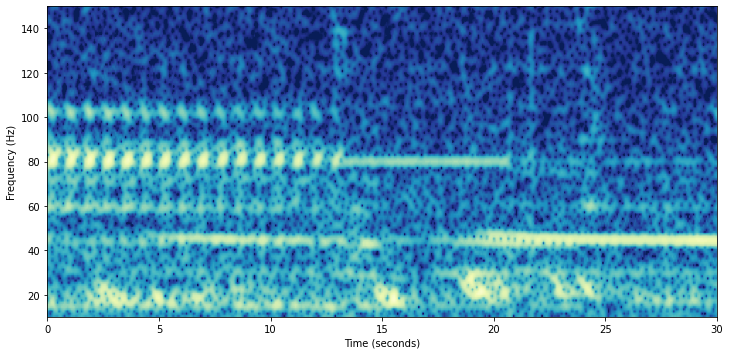

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 117700, End time:117730
Annotations:A NE Pacific=1, B NE Pacific=0


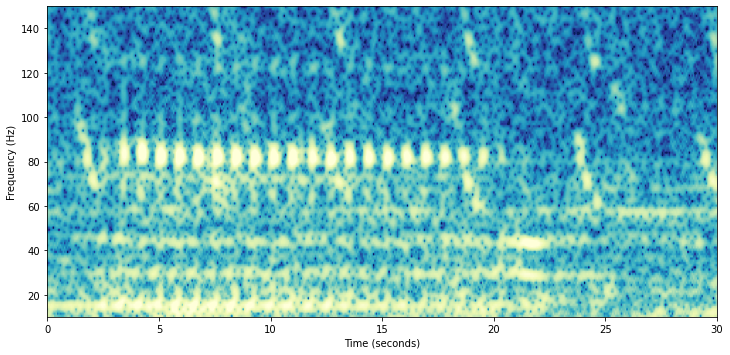

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 440, End time:470
Annotations:A NE Pacific=1, B NE Pacific=0


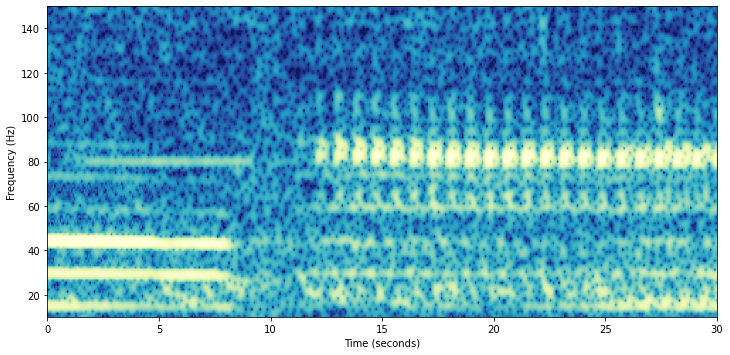

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 165260, End time:165290
Annotations:A NE Pacific=1, B NE Pacific=0


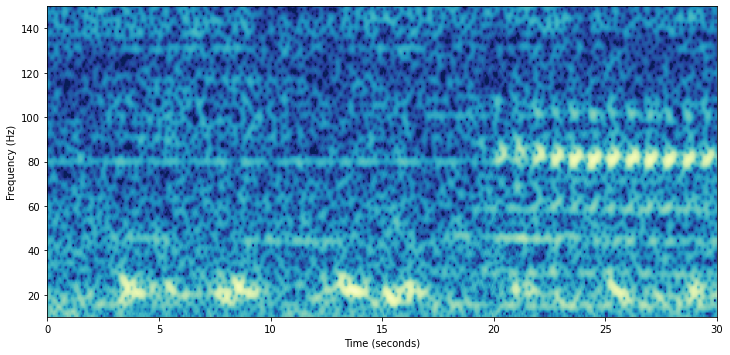

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 172240, End time:172270
Annotations:A NE Pacific=1, B NE Pacific=0


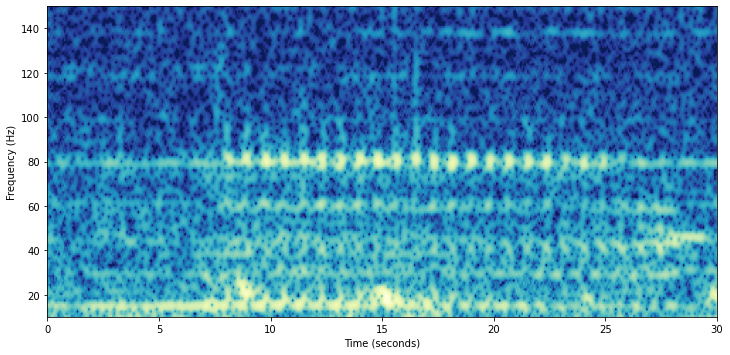

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 113920, End time:113950
Annotations:A NE Pacific=1, B NE Pacific=0


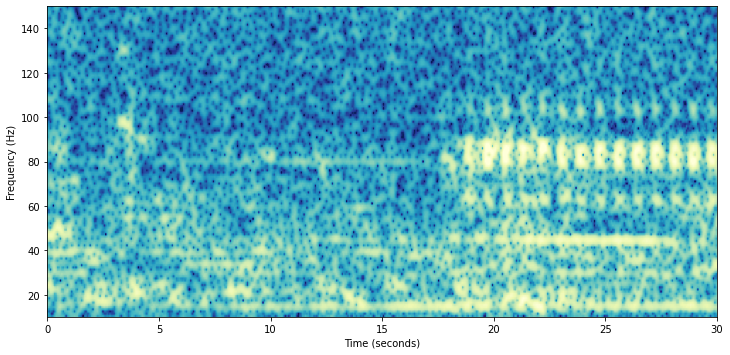

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 54740, End time:54770
Annotations:A NE Pacific=1, B NE Pacific=0


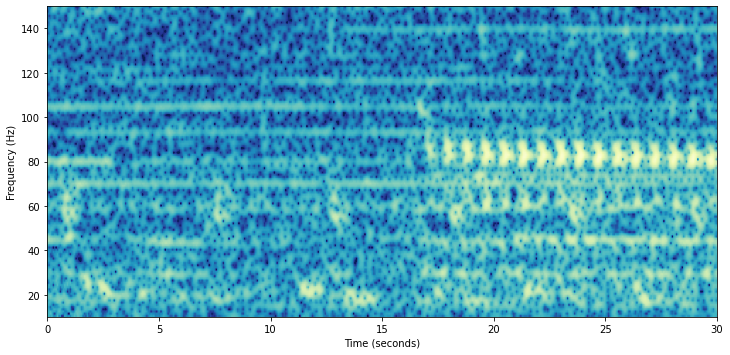

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 145240, End time:145270
Annotations:A NE Pacific=1, B NE Pacific=0


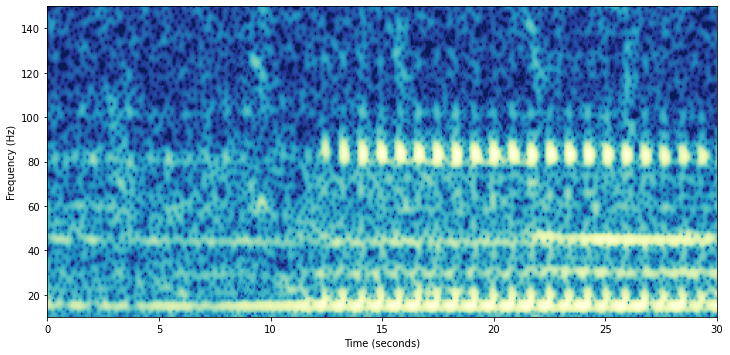

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 138920, End time:138950
Annotations:A NE Pacific=1, B NE Pacific=0


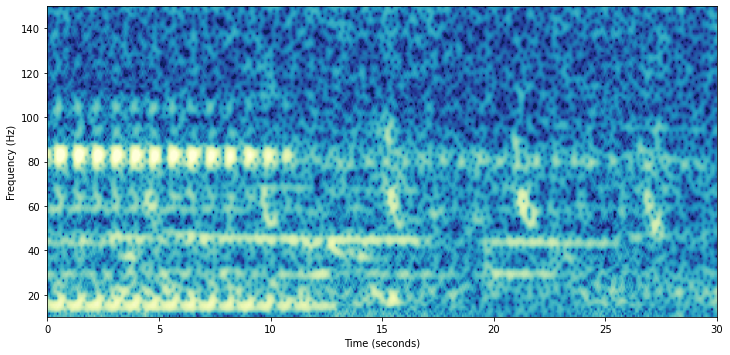

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 198080, End time:198110
Annotations:A NE Pacific=1, B NE Pacific=0


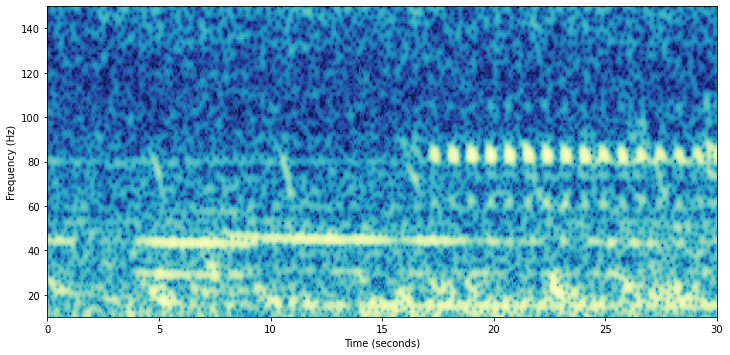

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 204480, End time:204510
Annotations:A NE Pacific=1, B NE Pacific=0


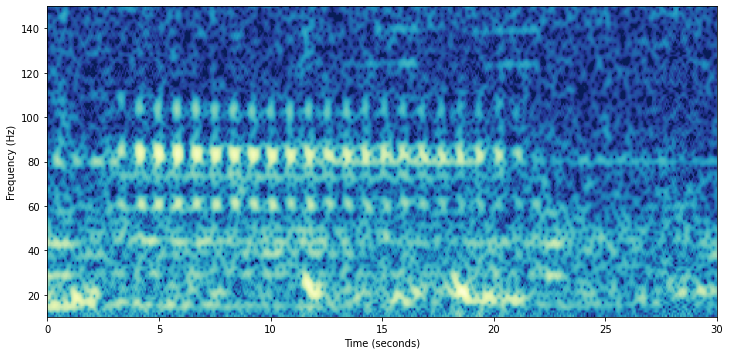

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 172940, End time:172970
Annotations:A NE Pacific=1, B NE Pacific=0


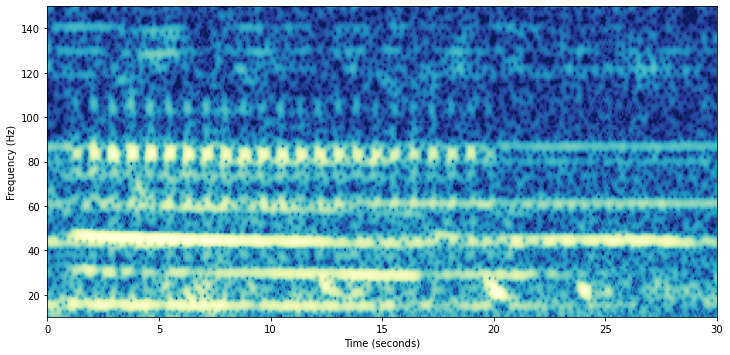

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 214000, End time:214030
Annotations:A NE Pacific=1, B NE Pacific=0


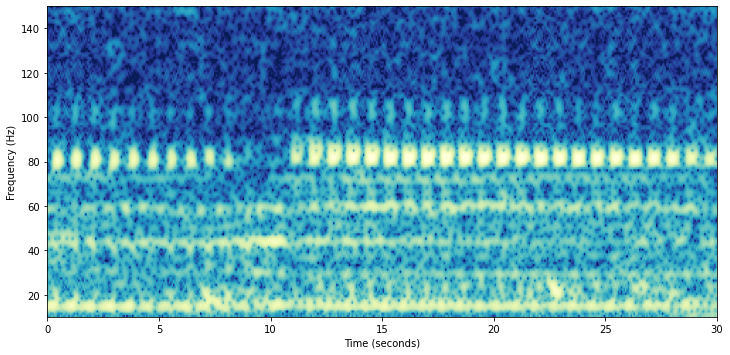

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 164400, End time:164430
Annotations:A NE Pacific=1, B NE Pacific=0


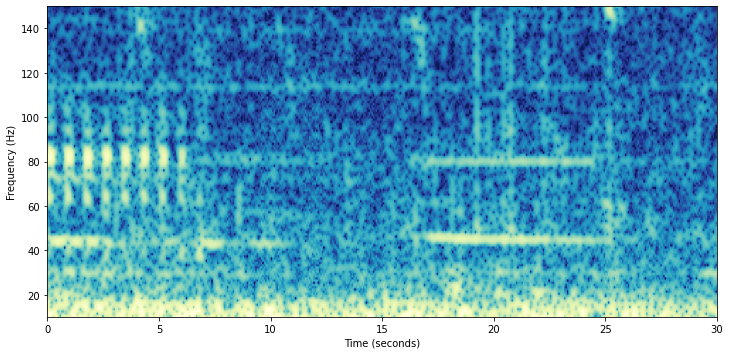

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 138440, End time:138470
Annotations:A NE Pacific=1, B NE Pacific=0


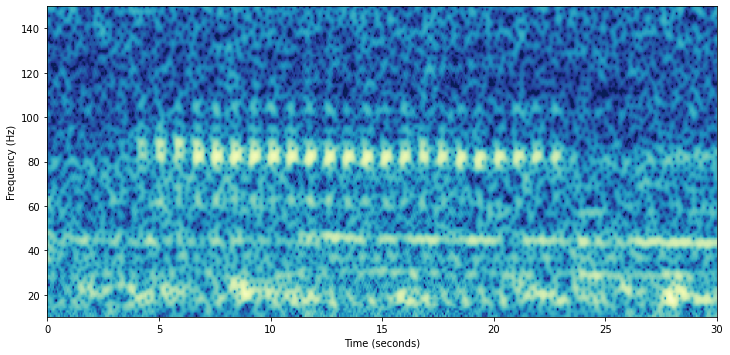

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 170960, End time:170990
Annotations:A NE Pacific=1, B NE Pacific=0


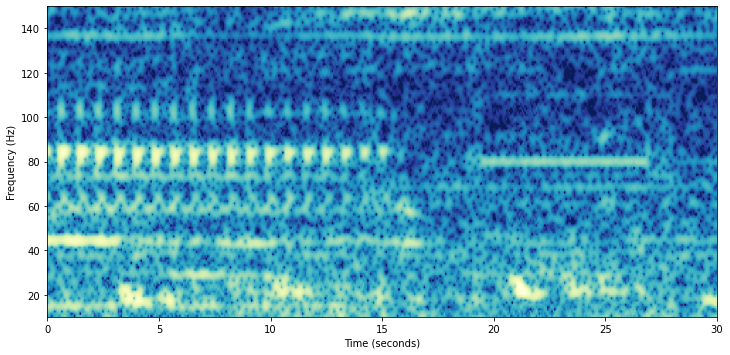

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 148400, End time:148430
Annotations:A NE Pacific=1, B NE Pacific=0


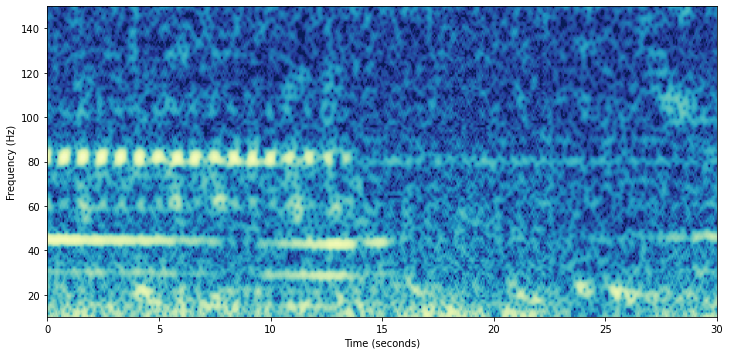

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 181380, End time:181410
Annotations:A NE Pacific=1, B NE Pacific=0


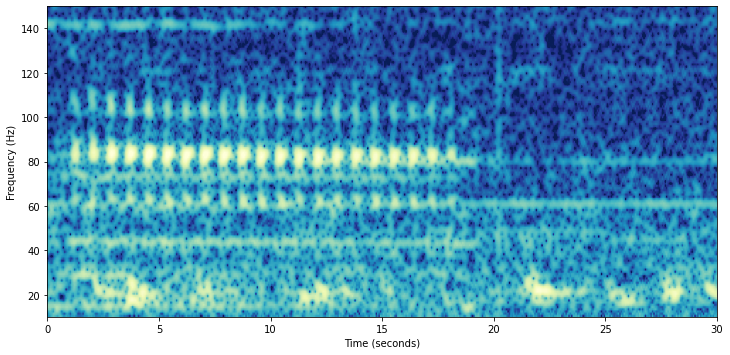

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 117980, End time:118010
Annotations:A NE Pacific=1, B NE Pacific=0


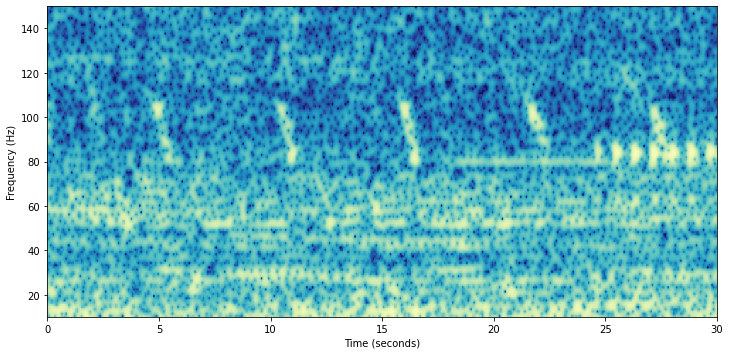

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 76620, End time:76650
Annotations:A NE Pacific=1, B NE Pacific=0


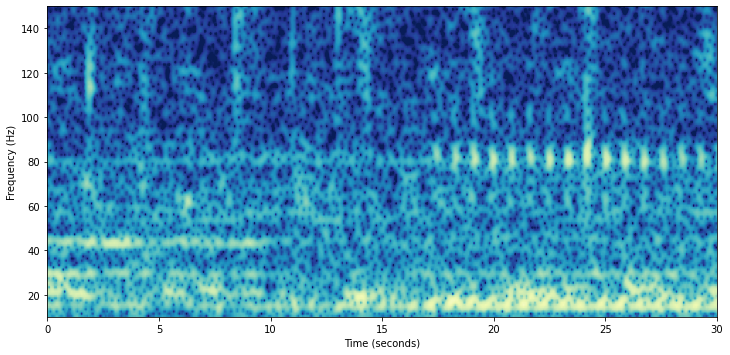

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 224540, End time:224570
Annotations:A NE Pacific=1, B NE Pacific=0


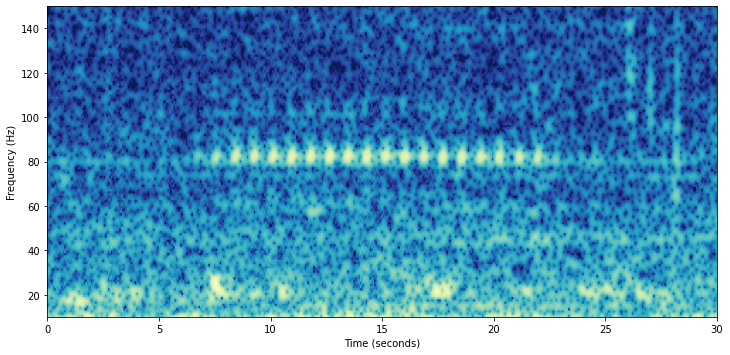

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 169860, End time:169890
Annotations:A NE Pacific=1, B NE Pacific=0


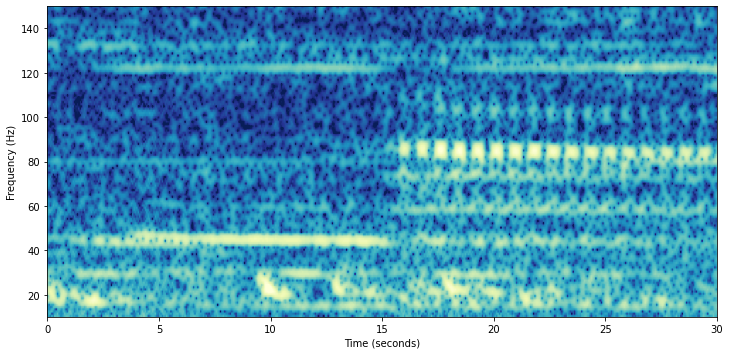

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 153440, End time:153470
Annotations:A NE Pacific=1, B NE Pacific=0


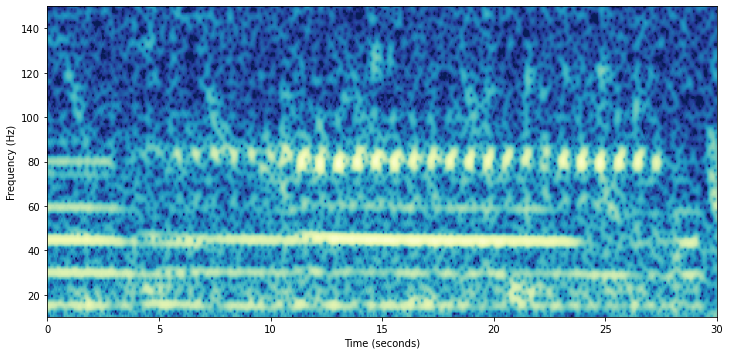

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 168060, End time:168090
Annotations:A NE Pacific=1, B NE Pacific=0


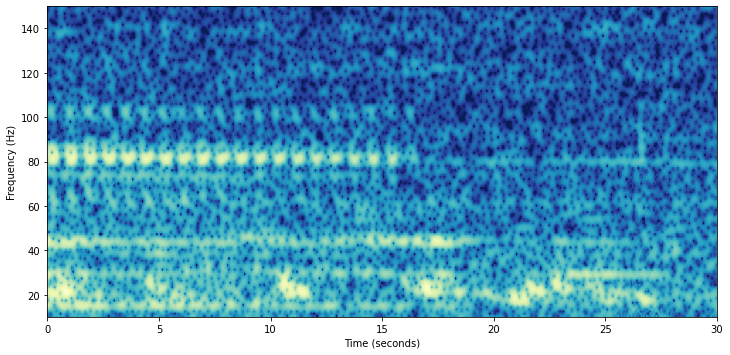

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 110820, End time:110850
Annotations:A NE Pacific=1, B NE Pacific=0


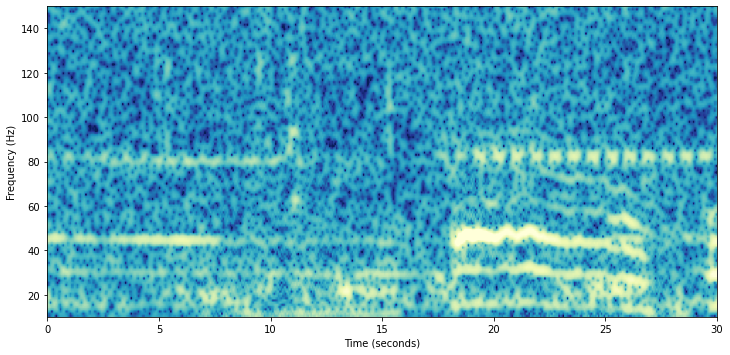

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 213440, End time:213470
Annotations:A NE Pacific=1, B NE Pacific=0


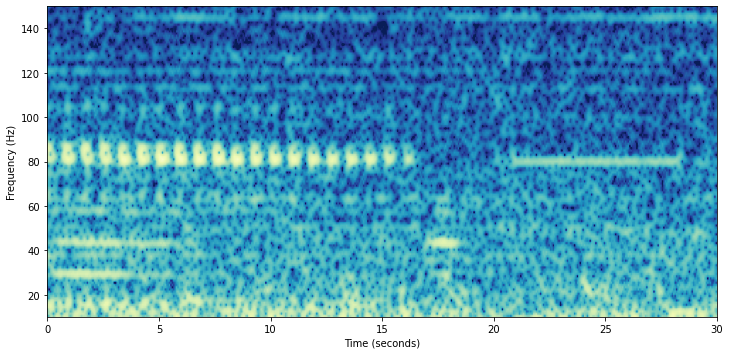

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 130440, End time:130470
Annotations:A NE Pacific=1, B NE Pacific=0


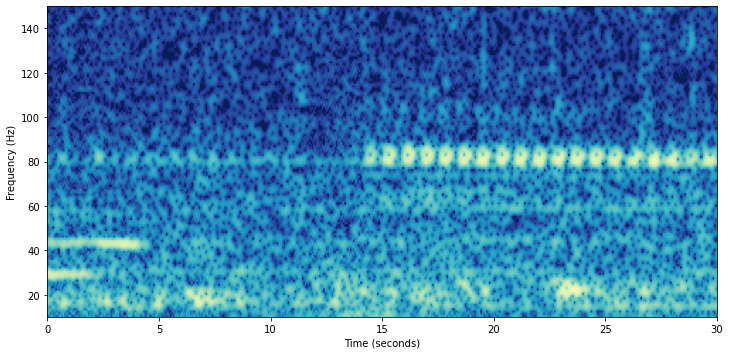

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 48540, End time:48570
Annotations:A NE Pacific=1, B NE Pacific=0


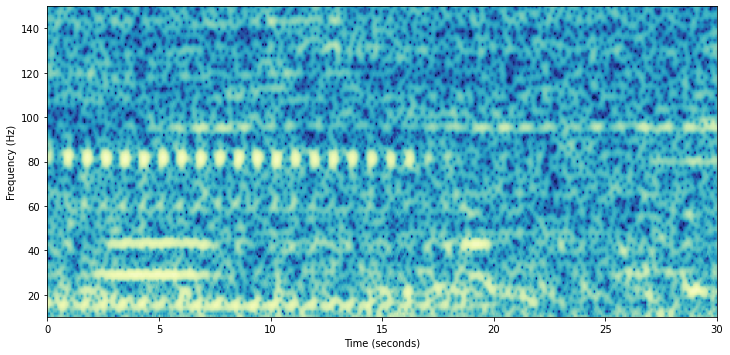

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 151160, End time:151190
Annotations:A NE Pacific=1, B NE Pacific=0


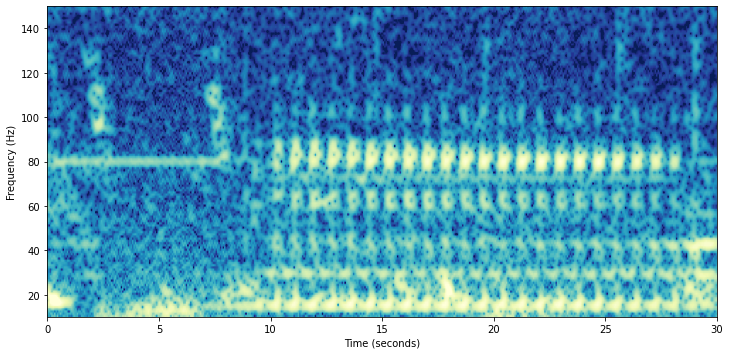

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 85740, End time:85770
Annotations:A NE Pacific=1, B NE Pacific=0


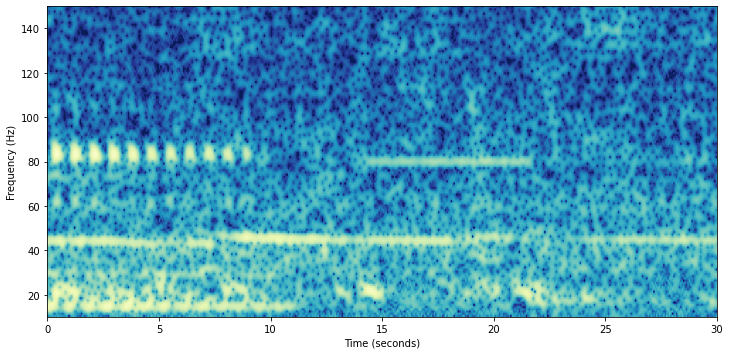

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 212060, End time:212090
Annotations:A NE Pacific=1, B NE Pacific=0


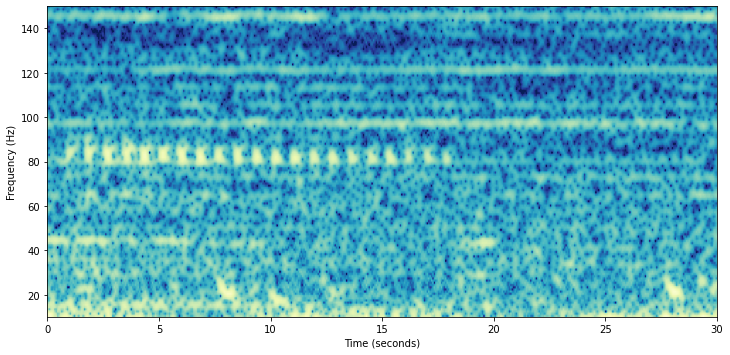

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 98060, End time:98090
Annotations:A NE Pacific=1, B NE Pacific=0


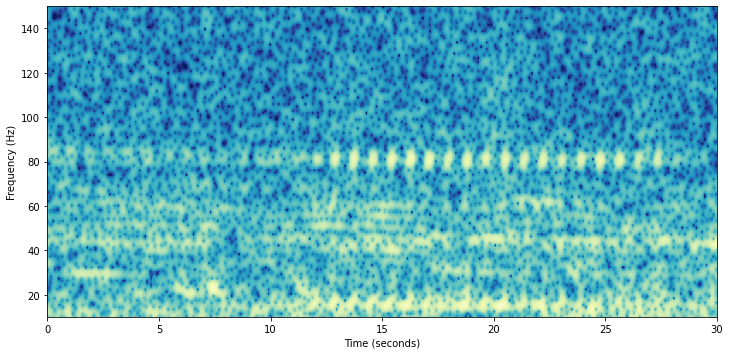

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 176180, End time:176210
Annotations:A NE Pacific=1, B NE Pacific=0


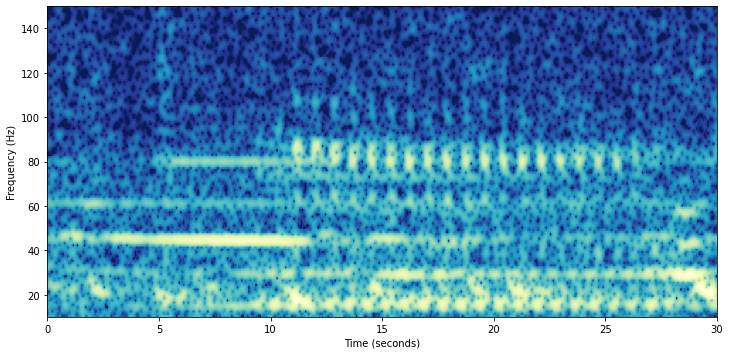

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 205920, End time:205950
Annotations:A NE Pacific=1, B NE Pacific=0


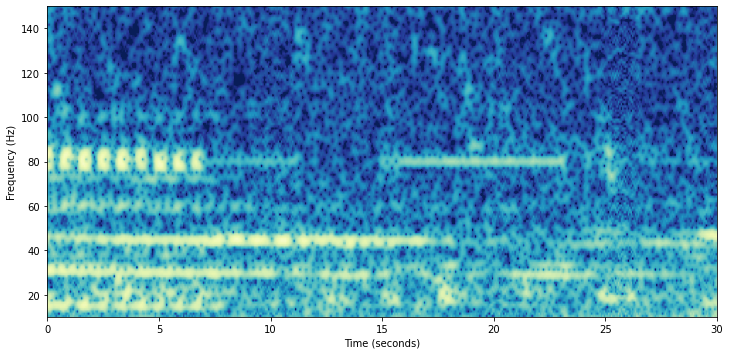

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 224640, End time:224670
Annotations:A NE Pacific=1, B NE Pacific=0


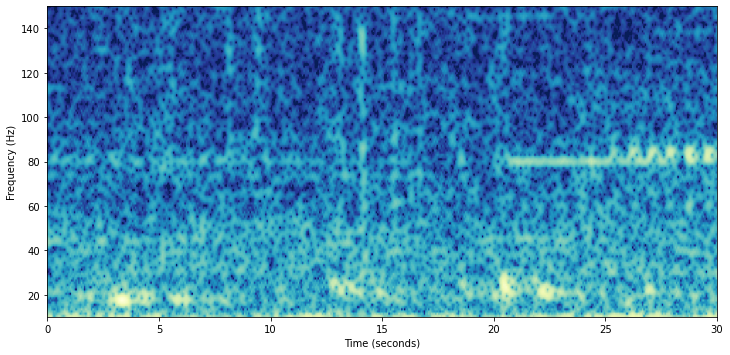

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 112500, End time:112530
Annotations:A NE Pacific=1, B NE Pacific=0


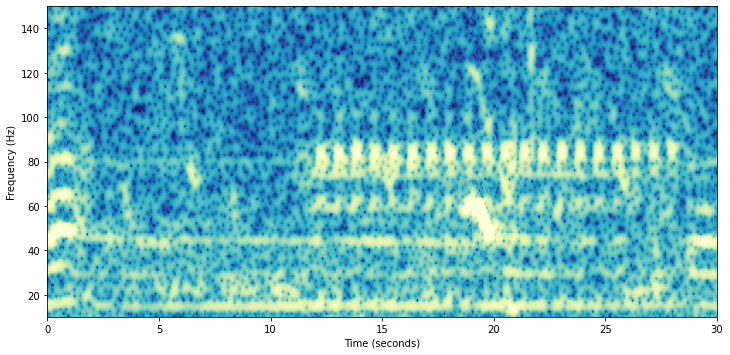

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 213780, End time:213810
Annotations:A NE Pacific=1, B NE Pacific=0


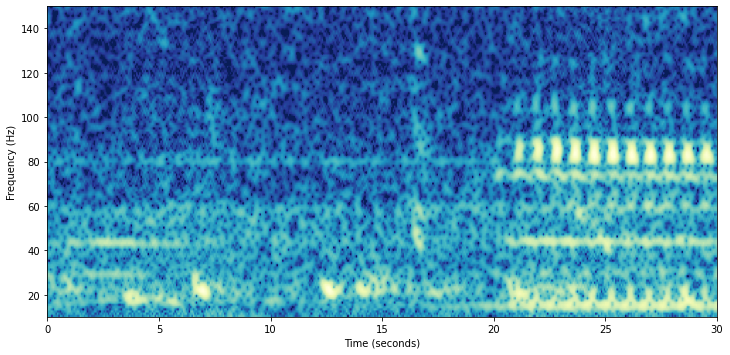

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 109180, End time:109210
Annotations:A NE Pacific=1, B NE Pacific=0


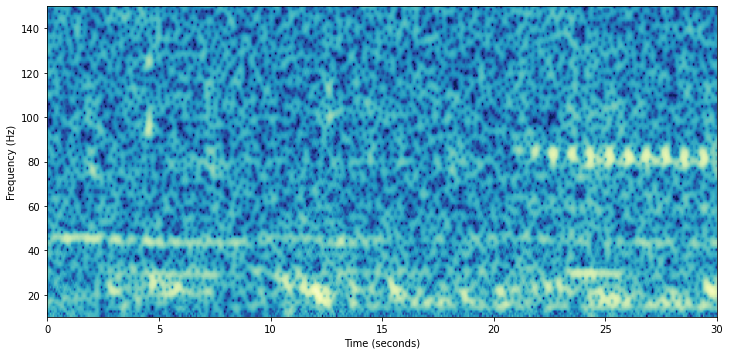

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 98900, End time:98930
Annotations:A NE Pacific=1, B NE Pacific=0


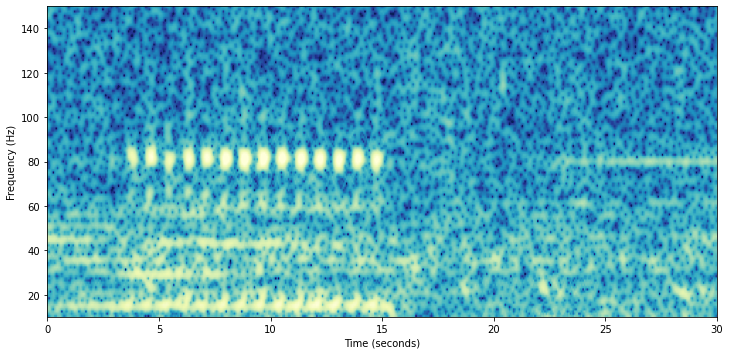

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 6460, End time:6490
Annotations:A NE Pacific=1, B NE Pacific=0


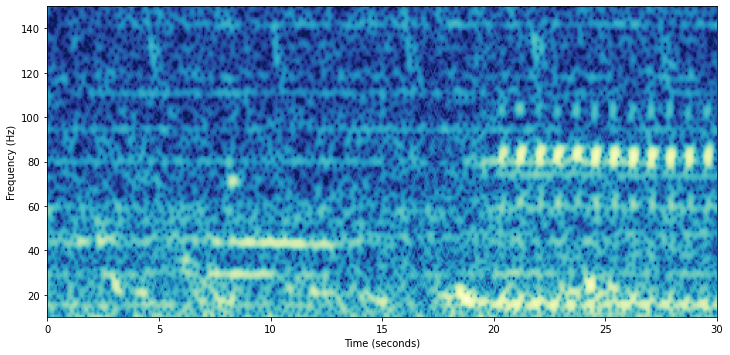

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 71860, End time:71890
Annotations:A NE Pacific=1, B NE Pacific=0


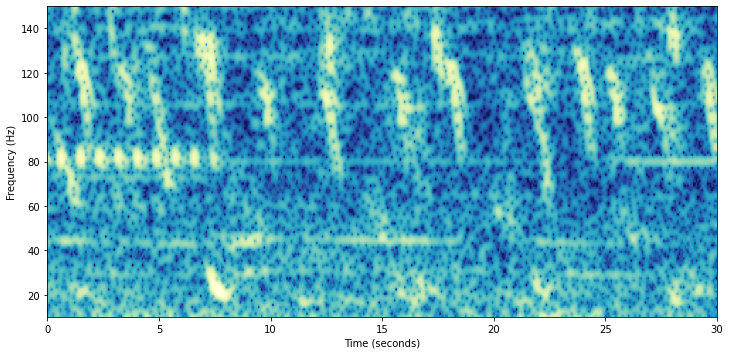

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 222320, End time:222350
Annotations:A NE Pacific=1, B NE Pacific=0


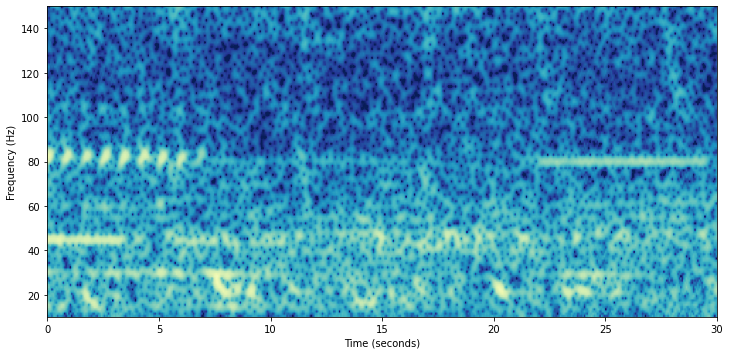

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 1160, End time:1190
Annotations:A NE Pacific=1, B NE Pacific=1


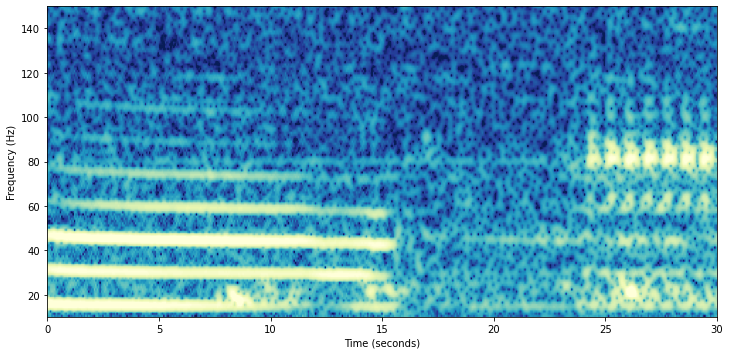

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 209940, End time:209970
Annotations:A NE Pacific=1, B NE Pacific=0


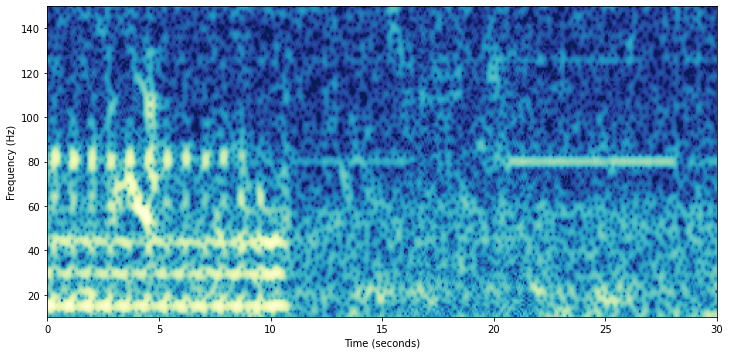

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 93120, End time:93150
Annotations:A NE Pacific=1, B NE Pacific=0


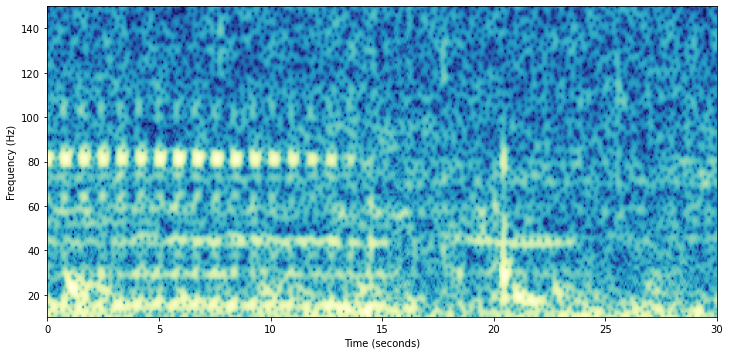

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 96960, End time:96990
Annotations:A NE Pacific=1, B NE Pacific=0


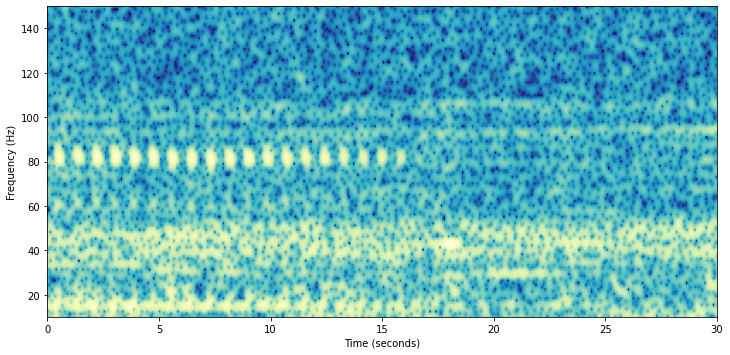

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 217920, End time:217950
Annotations:A NE Pacific=1, B NE Pacific=0


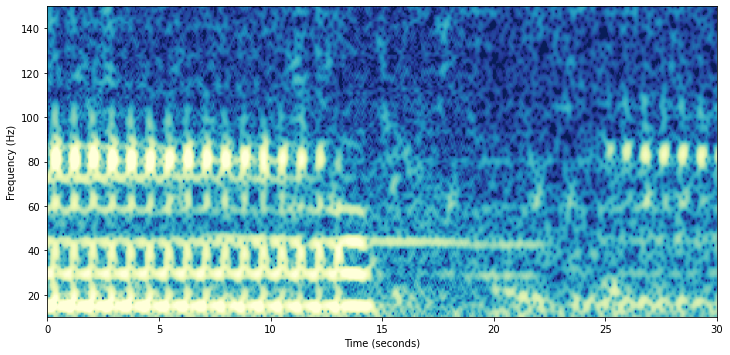

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 104720, End time:104750
Annotations:A NE Pacific=1, B NE Pacific=0


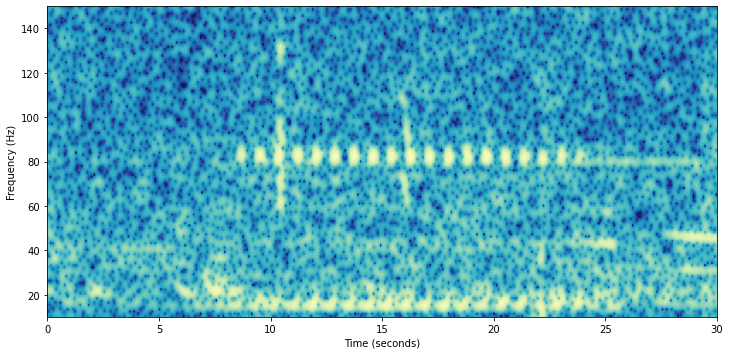

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 169320, End time:169350
Annotations:A NE Pacific=1, B NE Pacific=0


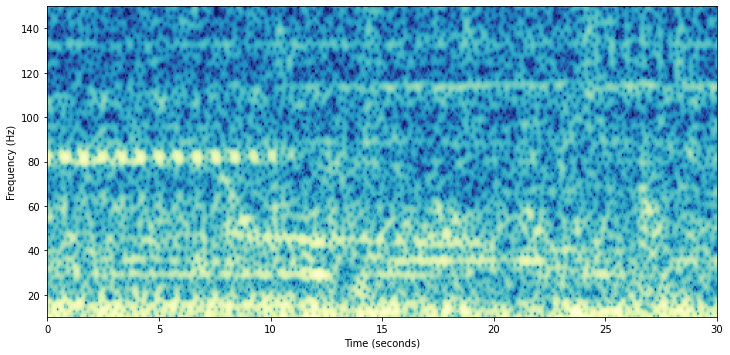

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 145880, End time:145910
Annotations:A NE Pacific=1, B NE Pacific=0


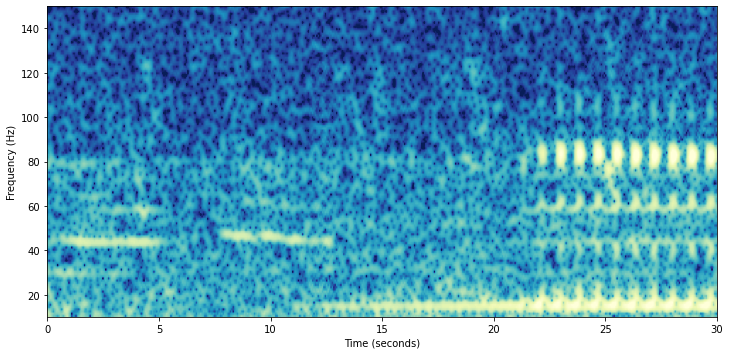

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 91780, End time:91810
Annotations:A NE Pacific=1, B NE Pacific=0


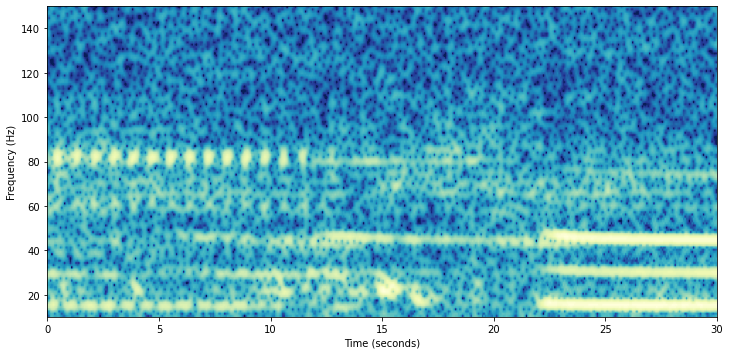

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 84340, End time:84370
Annotations:A NE Pacific=1, B NE Pacific=0


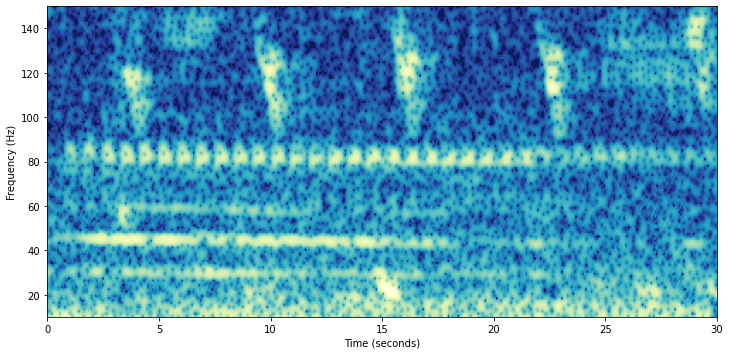

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 196280, End time:196310
Annotations:A NE Pacific=1, B NE Pacific=0


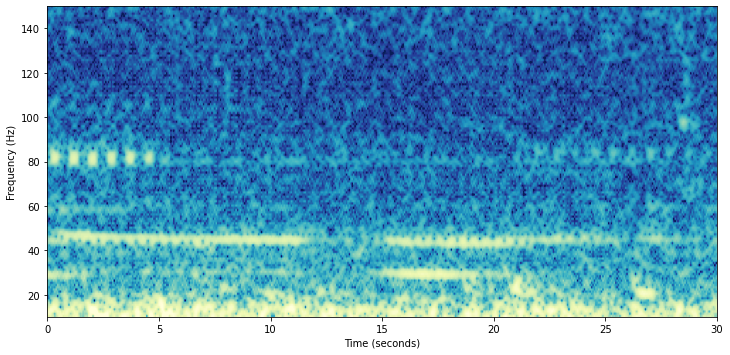

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 148260, End time:148290
Annotations:A NE Pacific=1, B NE Pacific=0


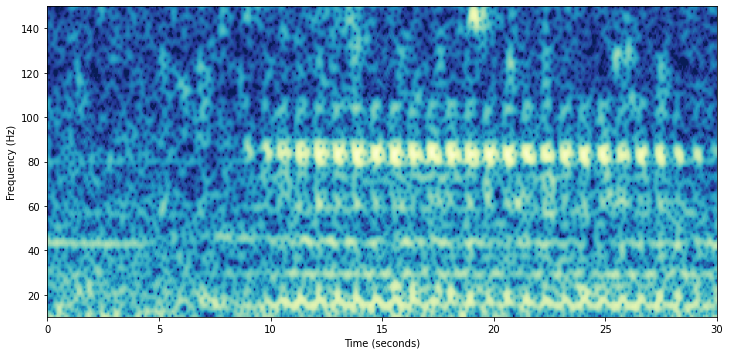

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 33780, End time:33810
Annotations:A NE Pacific=1, B NE Pacific=0


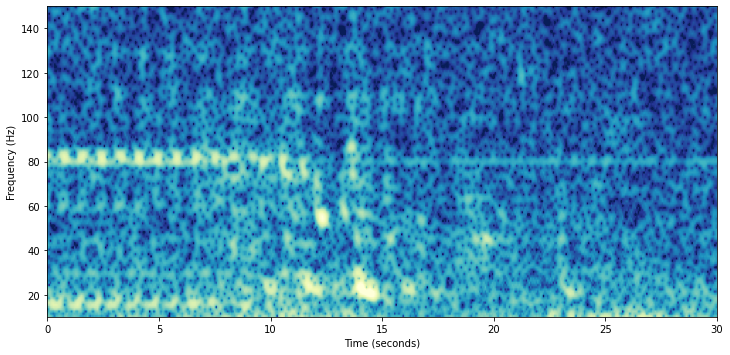

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 169120, End time:169150
Annotations:A NE Pacific=1, B NE Pacific=0


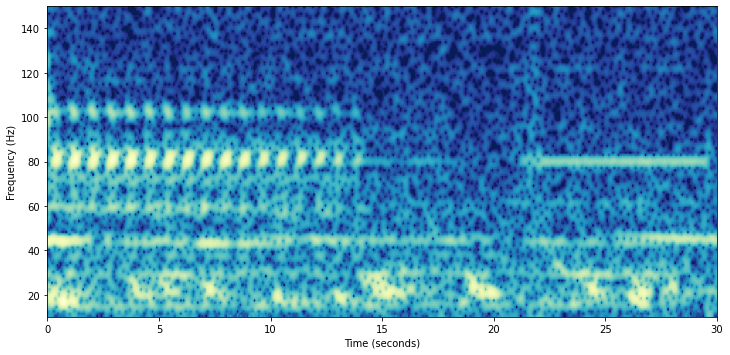

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 162320, End time:162350
Annotations:A NE Pacific=1, B NE Pacific=0


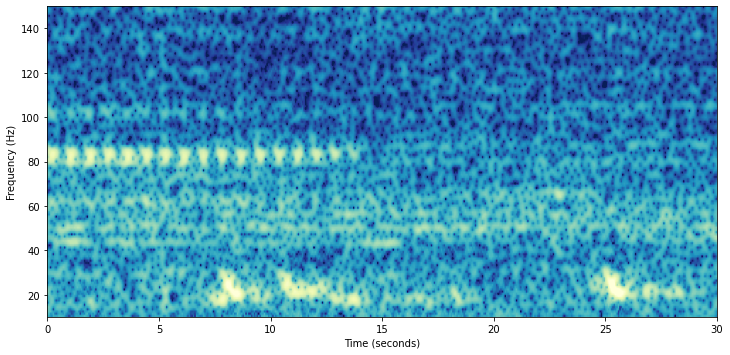

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 232740, End time:232770
Annotations:A NE Pacific=1, B NE Pacific=0


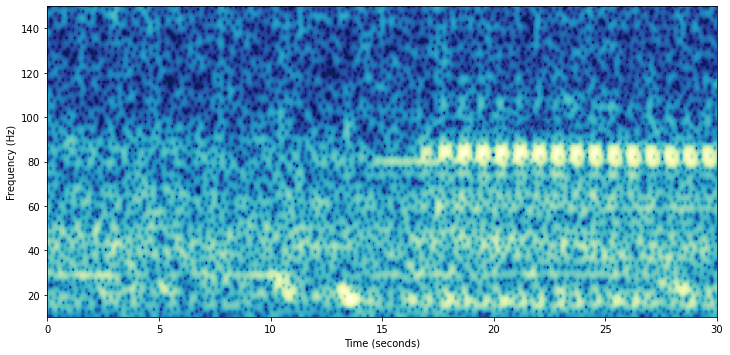

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 105220, End time:105250
Annotations:A NE Pacific=1, B NE Pacific=0


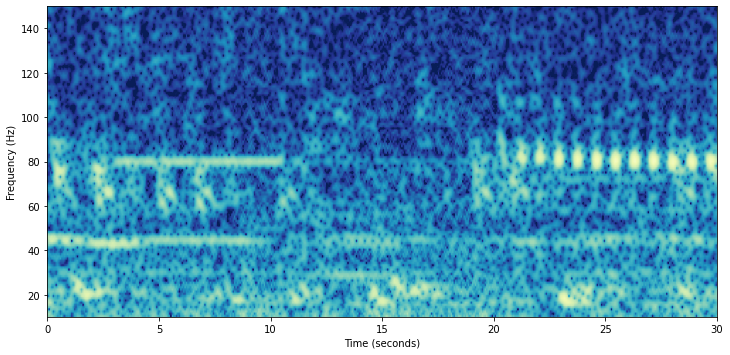

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 221120, End time:221150
Annotations:A NE Pacific=1, B NE Pacific=0


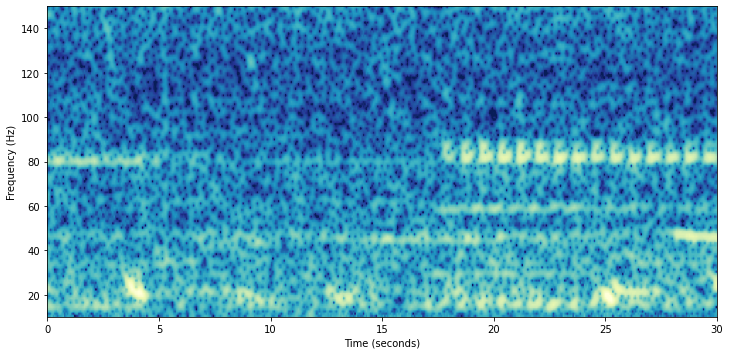

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 214460, End time:214490
Annotations:A NE Pacific=1, B NE Pacific=1


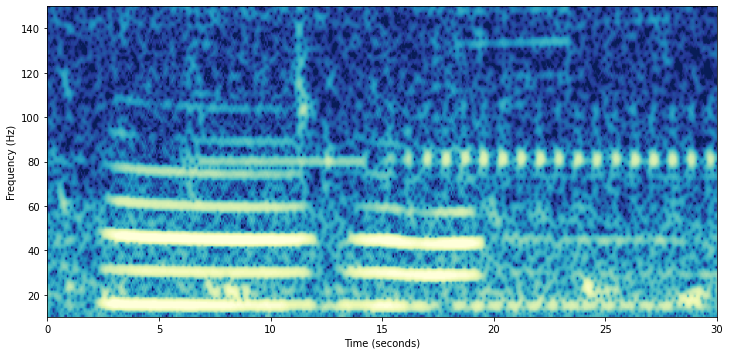

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 164800, End time:164830
Annotations:A NE Pacific=1, B NE Pacific=0


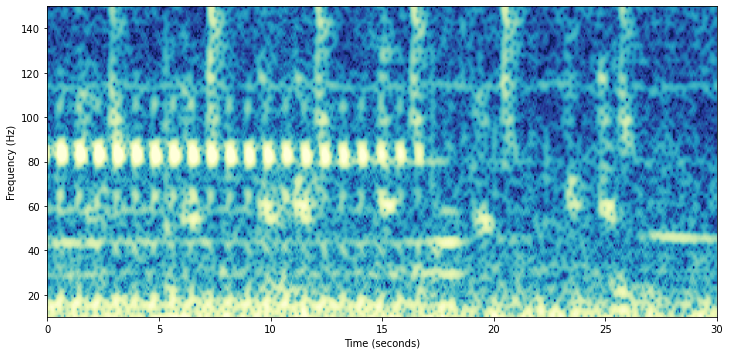

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 34120, End time:34150
Annotations:A NE Pacific=1, B NE Pacific=0


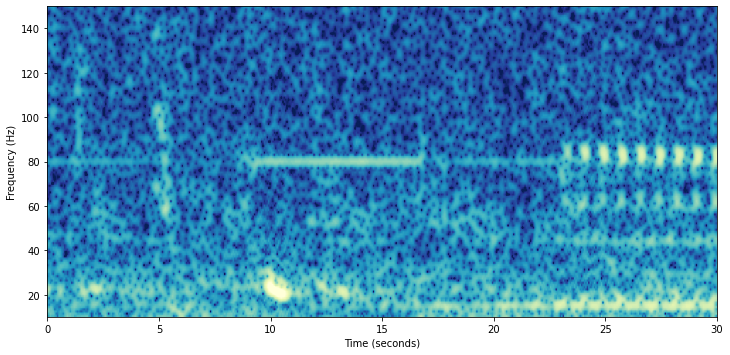

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 200780, End time:200810
Annotations:A NE Pacific=1, B NE Pacific=0


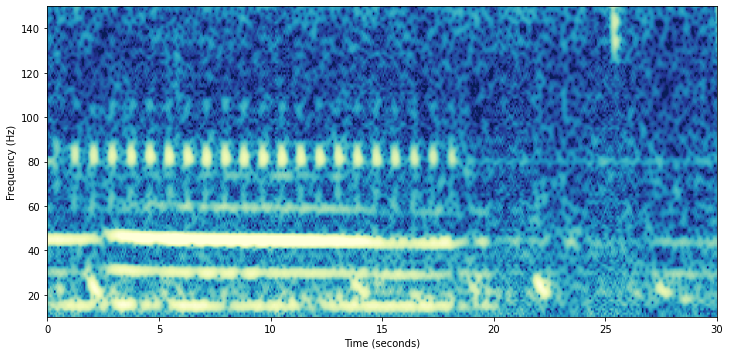

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 215900, End time:215930
Annotations:A NE Pacific=1, B NE Pacific=0


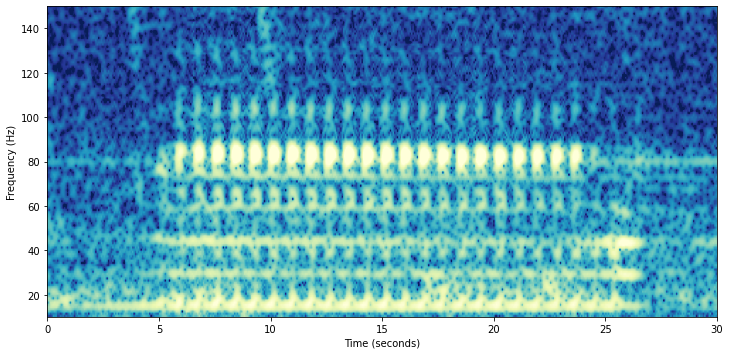

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 123740, End time:123770
Annotations:A NE Pacific=1, B NE Pacific=0


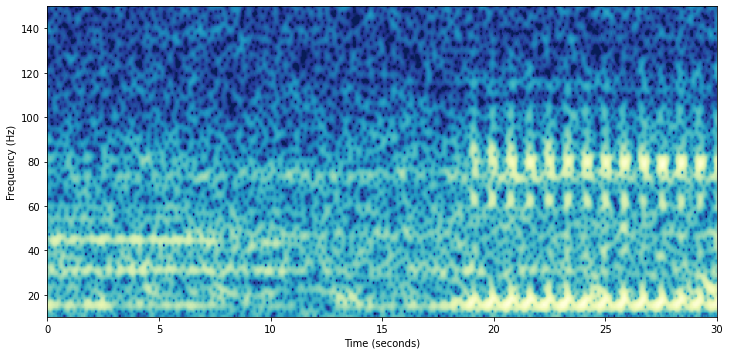

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 215200, End time:215230
Annotations:A NE Pacific=1, B NE Pacific=0


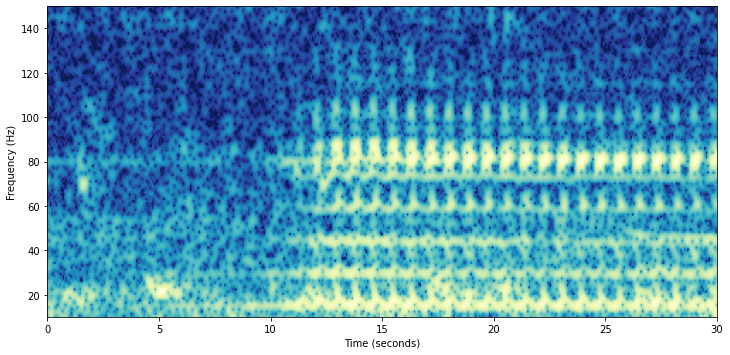

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 81760, End time:81790
Annotations:A NE Pacific=1, B NE Pacific=0


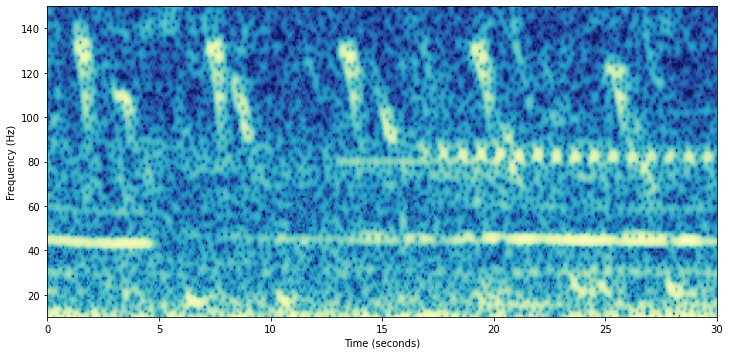

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 127900, End time:127930
Annotations:A NE Pacific=1, B NE Pacific=0


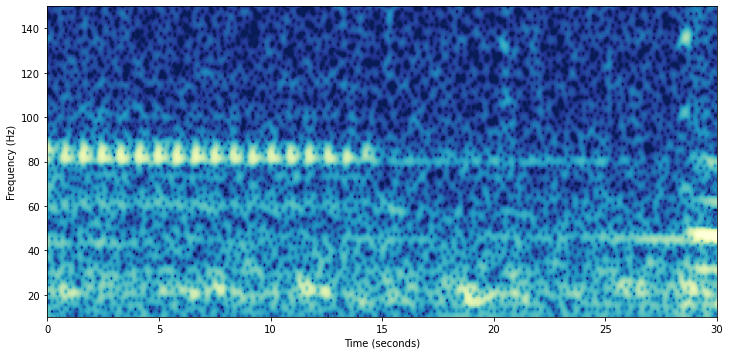

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 151760, End time:151790
Annotations:A NE Pacific=1, B NE Pacific=0


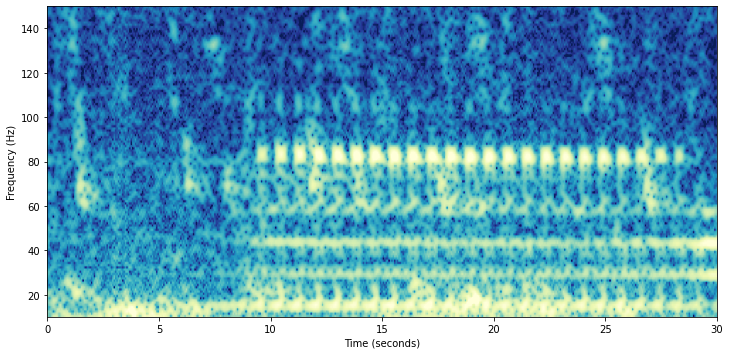

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 52160, End time:52190
Annotations:A NE Pacific=1, B NE Pacific=0


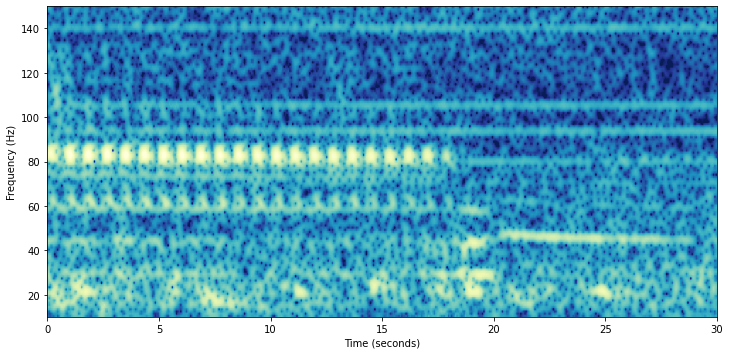

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 232440, End time:232470
Annotations:A NE Pacific=1, B NE Pacific=0


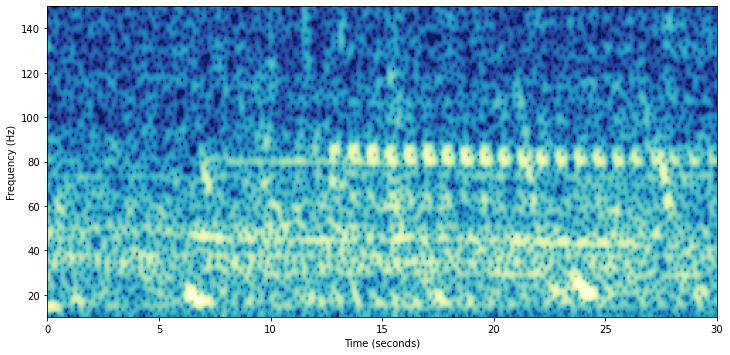

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 92600, End time:92630
Annotations:A NE Pacific=1, B NE Pacific=0


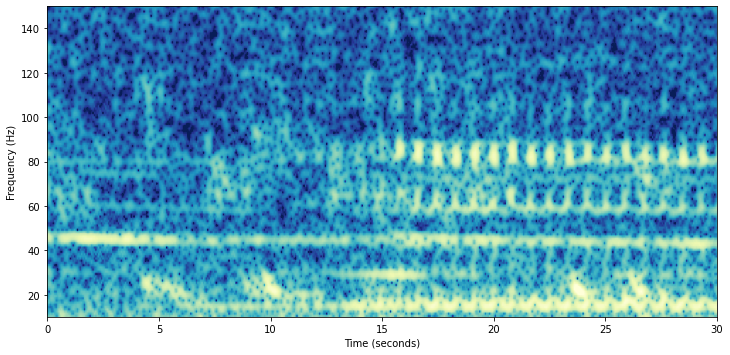

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 116140, End time:116170
Annotations:A NE Pacific=1, B NE Pacific=0


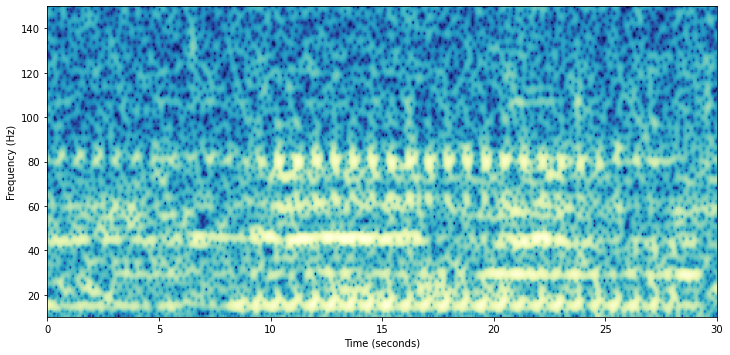

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 107860, End time:107890
Annotations:A NE Pacific=1, B NE Pacific=0


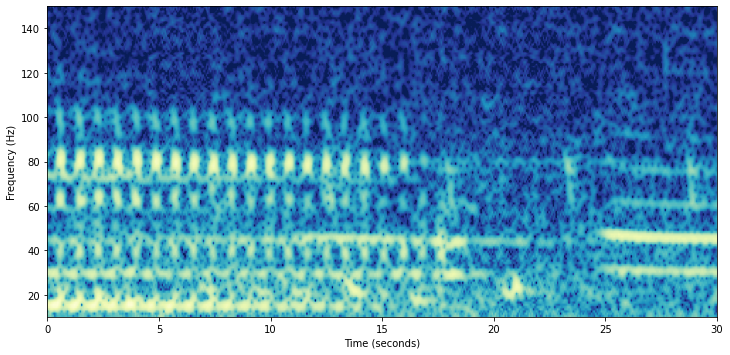

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 187420, End time:187450
Annotations:A NE Pacific=1, B NE Pacific=0


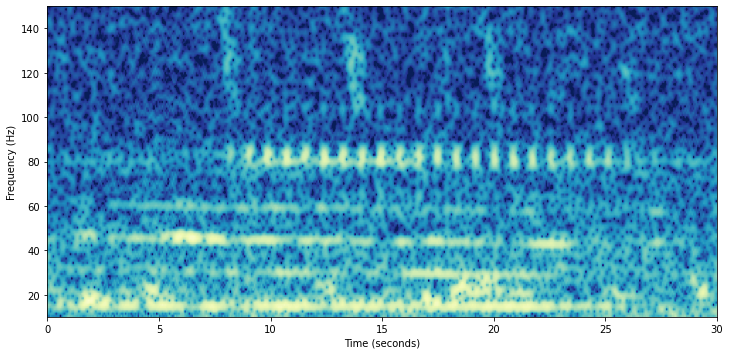

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 6340, End time:6370
Annotations:A NE Pacific=1, B NE Pacific=0


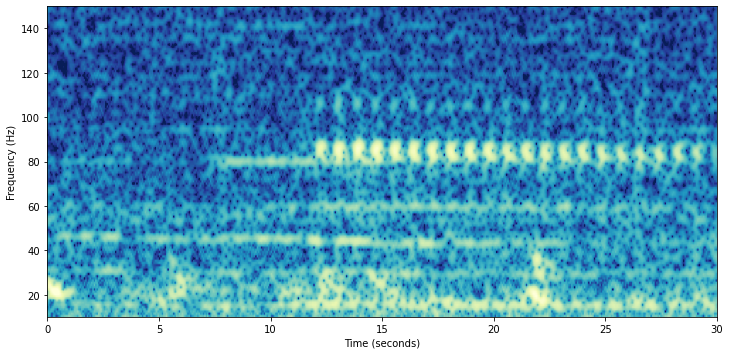

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 172280, End time:172310
Annotations:A NE Pacific=1, B NE Pacific=0


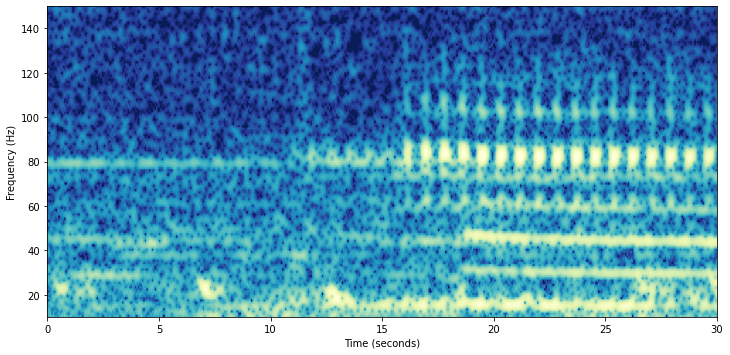

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 203780, End time:203810
Annotations:A NE Pacific=1, B NE Pacific=0


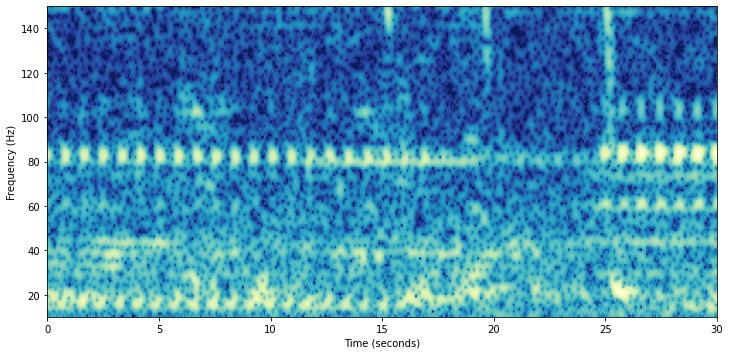

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 201640, End time:201670
Annotations:A NE Pacific=1, B NE Pacific=0


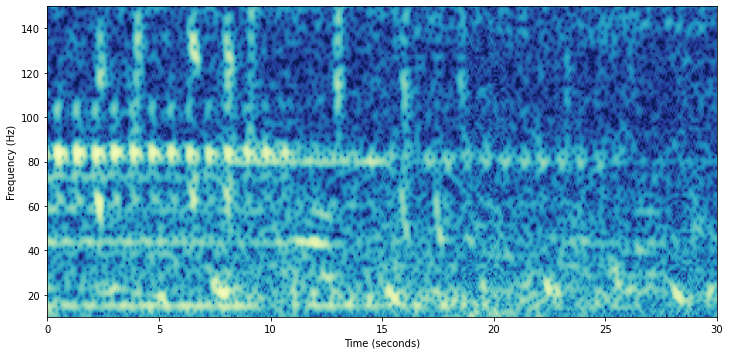

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 219640, End time:219670
Annotations:A NE Pacific=1, B NE Pacific=0


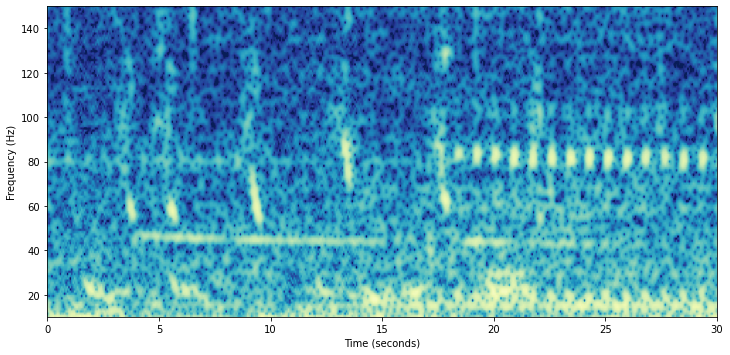

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 186240, End time:186270
Annotations:A NE Pacific=1, B NE Pacific=0


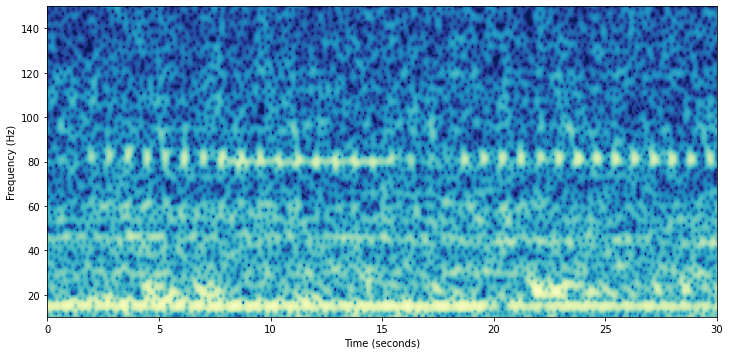

File:DCPP01A_d01_121112_122652.d100.x.wav
Start time: 29240, End time:29270
Annotations:A NE Pacific=1, B NE Pacific=0


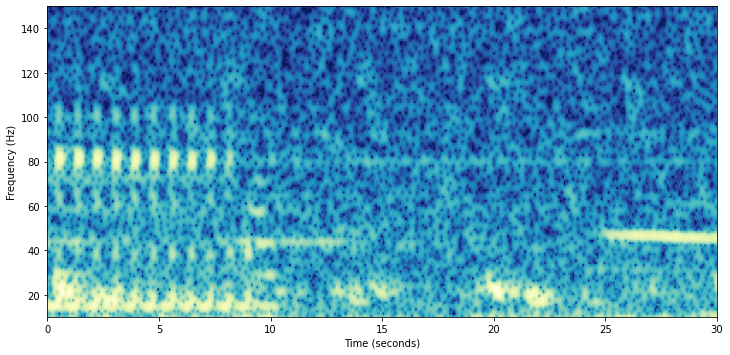

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 136360, End time:136390
Annotations:A NE Pacific=1, B NE Pacific=0


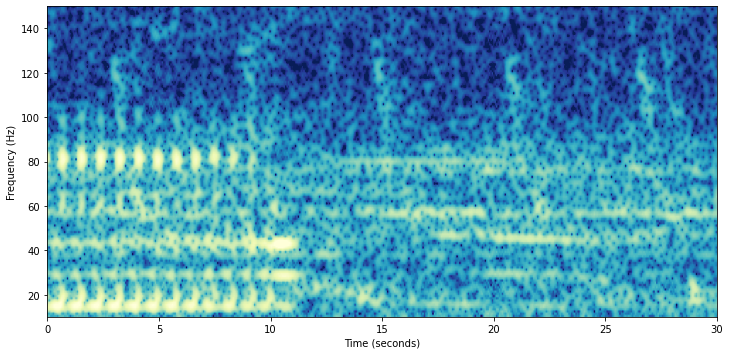

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 148880, End time:148910
Annotations:A NE Pacific=1, B NE Pacific=0


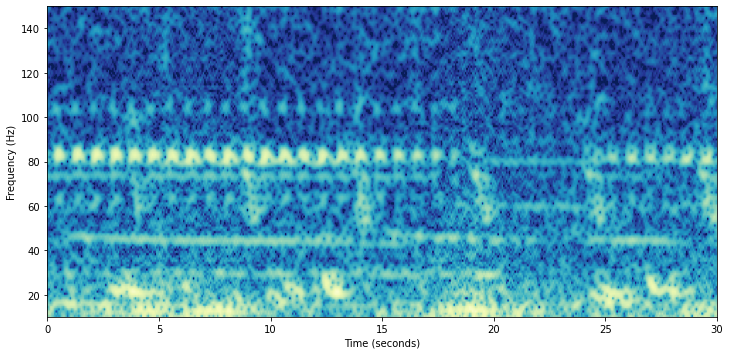

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 200900, End time:200930
Annotations:A NE Pacific=1, B NE Pacific=1


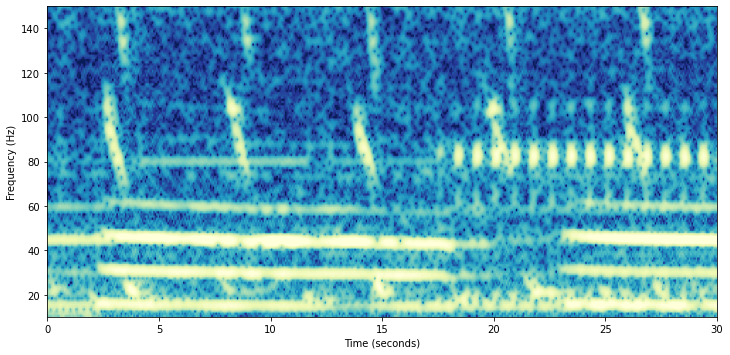

File:DCPP01A_d01_121109_191242.d100.x.wav
Start time: 122420, End time:122450
Annotations:A NE Pacific=1, B NE Pacific=0


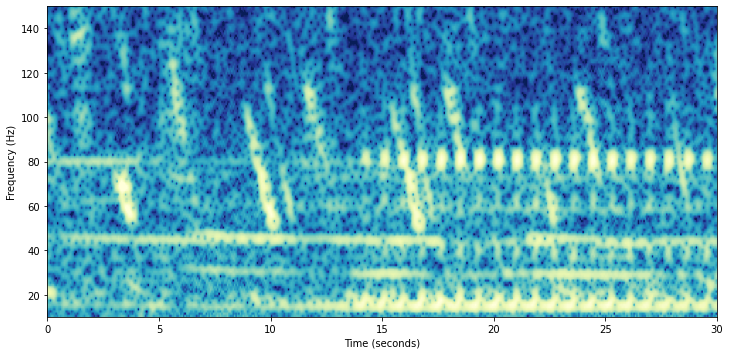

In [93]:
# plot the first x number of spectrograms 

# Set a counter to track the number of spectrograms plotted
spectrogram_count = 0 # Look at the x through y spectrogram in the dataset 
# Iterate through the rows in the DataFrame
palette = sns.color_palette("RdYlBu", as_cmap=True) #use colorbrewer palette 
palette = sns.color_palette("YlGnBu_r", as_cmap=True) #use colorbrewer palette 
output_dir = Path('../../reports/figures')
for index, row in train_clips.iterrows():
    # Check if the number of plotted spectrograms has reached whatever number you set
    if spectrogram_count >= 100:
        break  # Exit the loop if x spectrograms have been plotted
    annotations = [row['A NE Pacific'], row['B NE Pacific']]
    start = [row['start_time']]
    end = [row['end_time']]
    file =  os.path.split(row['file'])[1]

    # Extract relevant information from the row
    audio_file_name = os.path.split(row['file'])[1]
    audio = opensoundscape.Audio.from_file(row['file'], sample_rate=3200, offset=row['start_time'], duration=30)
    spec = opensoundscape.Spectrogram.from_audio(audio, window_type='hamming', window_samples=1600, 
                                                 overlap_samples=1400, fft_size=3200, 
                                                 decibel_limits=(-120, 150), scaling='density')

    # Plot the spectrogram
    spec_image = spec.bandpass(10, 150).to_image()

    width, height = 473, 141
    aspect_ratio = height / (width*3)  # This is the raw pixel aspect ratio
    plt.figure(figsize=(12, 8))
    plt.imshow(spec_image, aspect=aspect_ratio, extent=[0, 30, 10, 150], cmap = palette, vmin = 5, vmax=55)
    plt.axis('on')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Frequency (Hz)')
   
    # Increment the spectrogram counter
    spectrogram_count += 1
    # Show the plotted spectrograms
    print(f'File:{file}')
    print(f'Start time: {start[0]}, End time:{end[0]}')
    print(f'Annotations:A NE Pacific={annotations[0]}, B NE Pacific={annotations[1]}')

    file_name = f'spectrogram_{spectrogram_count}_{os.path.basename(row["file"]).replace(".wav", "")}.png'
    file_path = os.path.join(output_dir, file_name)

    # Save the figure to a file
    plt.savefig(file_path, format='png', bbox_inches='tight', pad_inches=0.1)
    plt.show()
